In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import os
import torchvision
from torchvision.transforms import transforms
from PIL import Image
import matplotlib.pyplot as plt
from PIL.Image import Image as PilImage
import textwrap, os


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [2]:
def load_model(weights_path):
    class LinearNet(nn.Module):
        def __init__(self, backbone):
            super(LinearNet, self).__init__()
            
            self.backbone = backbone
            self.backbone.fc = nn.Linear(512, 512)
            self.fc = nn.Linear(512, 1)
            self.sig = nn.Sigmoid()
            
        def forward(self, x):
            x = self.backbone(F.normalize(x))
            x = self.fc(F.normalize(x))
            return self.sig(x)
        
    resnet = torchvision.models.resnet18()
    model = LinearNet(resnet)

    model.load_state_dict(torch.load(weights_path))
    return model

def calc_score(model, ex):
    return model(transform(ex).unsqueeze(0).to(device))

transform = transforms.Compose([
    transforms.Resize((224, 224)), 
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
])

In [3]:
def get_images_with_scores(path):
    model = load_model('weights/classifier_weights.pt')
    model.eval()

    res = []
    for filename in os.listdir(path):
        if filename.endswith(".png"):
            ex = Image.open(os.path.join(path, filename)).convert('RGB')
            res.append((
                model(transform(ex).unsqueeze(0).to(device))[0][0].item(),
                ex,
                
                ))
        
    res.sort()

    images = [i[1] for i in res]
    scores = [i[0] for i in res]
    return images, scores

In [4]:
paths = ["conceptual_results", "not_conceptual_results", "default_sd_results"]

for path in paths:
    images, scores = get_images_with_scores(path)
    metric = sum(scores)/len(scores)
    print(f"Значение метрики классификатора для {path}: {metric}")

Значение метрики классификатора для conceptual_results: 0.2738525751564238
Значение метрики классификатора для not_conceptual_results: 0.15357754975557328
Значение метрики классификатора для default_sd_results: 0.22902840316029532


In [5]:
def display_images(
    images, 
    titles,
    columns=1, width=20, height=8, max_images=100, 
    label_wrap_length=50, label_font_size=18):

    if not images:
        print("No images to display.")
        return 

    if len(images) > max_images:
        print(f"Showing {max_images} images of {len(images)}:")
        images=images[0:max_images]

    height = max(height, int(len(images)/columns) * height)
    plt.figure(figsize=(width, height))
    for i, image in enumerate(images):

        plt.subplot(int(len(images) / columns + 1), columns, i + 1)
        plt.imshow(image)
        
        title = 1-titles[i]
        plt.title(f'LOGO Score: {"{0:0.2f}".format(title)}', fontsize=label_font_size)
        plt.axis('off')

Отранжированные логотипы


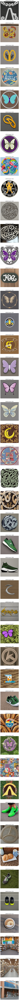

In [6]:
images, scores = get_images_with_scores(paths[0])
print("Отранжированные логотипы")
display_images(images, scores)